In [1]:
import torch
from torch import nn
import torch.nn.functional as F
import functools
import numpy as np
import matplotlib.pyplot as plt
import os
from torchvision import transforms
from math import pi
import SimpleITK as sitk
import plotly
import plotly.express as px
import plotly.graph_objects as go
import pandas as pd
from torch.utils.data import Dataset, DataLoader
import vtk
from vtk.util.numpy_support import vtk_to_numpy
import pickle
from monai.transforms import (RandSimulateLowResolution)

alpha_coeff_boundary_map = 0.1
beta_coeff_scattering = 10  #100 approximates it closer
TGC = 8
CLAMP_VALS = True


def gaussian_kernel(size: int, mean: float, std: float):
    d1 = torch.distributions.Normal(mean, std)
    d2 = torch.distributions.Normal(mean, std*3)
    vals_x = d1.log_prob(torch.arange(-size, size+1, dtype=torch.float32)).exp()
    vals_y = d2.log_prob(torch.arange(-size, size+1, dtype=torch.float32)).exp()

    gauss_kernel = torch.einsum('i,j->ij', vals_x, vals_y)
    
    return gauss_kernel / torch.sum(gauss_kernel).reshape(1, 1)

g_kernel = gaussian_kernel(3, 0., 0.5)
g_kernel = torch.tensor(g_kernel[None, None, :, :])




To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


In [2]:
class UltrasoundRendering(torch.nn.Module):
    def __init__(self, num_labels=340, w=256, h=256, center_x=128.0, center_y=-20.0, r1=40.0, r2=224.0, theta=np.pi/4):
        super(UltrasoundRendering, self).__init__()               
        
        # df = pd.read_csv(acoustic_params_fn)        
        # accoustic_imped,attenuation,mu_0,mu_1,sigma_0
        self.num_labels = num_labels
        self.acoustic_impedance_dict = torch.nn.Parameter(torch.rand(self.num_labels))    # Z in MRayl
        self.attenuation_dict =    torch.nn.Parameter(torch.rand(self.num_labels))   # alpha in dB cm^-1 at 1 MHz
        self.mu_0_dict =           torch.nn.Parameter(torch.rand(self.num_labels)) # mu_0 - scattering_mu   mean brightness
        self.mu_1_dict =           torch.nn.Parameter(torch.rand(self.num_labels)) # mu_1 - scattering density, Nr of scatterers/voxel
        self.sigma_0_dict =        torch.nn.Parameter(torch.rand(self.num_labels)) # sigma_0 - scattering_sigma - brightness std
        
        self.grid = self.compute_grid(w, h, center_x, center_y, r1, r2, theta)
        self.inverse_grid = self.compute_grid_inverse(self.grid)
        
        self.grid = self.grid / torch.tensor([w, h]) * 2.0 - 1.0
        self.inverse_grid = self.inverse_grid / torch.tensor([w, h]) * 2.0 - 1.0
        
    def init_params(self, acoustic_params_fn):
        df = pd.read_csv(acoustic_params_fn)
        
        # accoustic_imped,attenuation,mu_0,mu_1,sigma_0
        self.acoustic_impedance_dict = torch.nn.Parameter(torch.tensor(df['accoustic_imped'], dtype=torch.float32))    # Z in MRayl
        self.attenuation_dict =    torch.nn.Parameter(torch.tensor(df['attenuation'], dtype=torch.float32))   # alpha in dB cm^-1 at 1 MHz
        self.mu_0_dict =           torch.nn.Parameter(torch.tensor(df['mu_0'], dtype=torch.float32)) # mu_0 - scattering_mu   mean brightness
        self.mu_1_dict =           torch.nn.Parameter(torch.tensor(df['mu_1'], dtype=torch.float32)) # mu_1 - scattering density, Nr of scatterers/voxel
        self.sigma_0_dict =        torch.nn.Parameter(torch.tensor(df['sigma_0'], dtype=torch.float32)) # sigma_0 - scattering_sigma - brightness std

    def compute_grid(self, w, h, center_x, center_y, r1, r2, theta):
        # Convert inputs to tensors
        angles = torch.linspace(-theta, theta, w)  # Angles from -theta to theta
        radii = torch.linspace(r1, r2, h)  # Linear space of radii

        # Calculate sin and cos for all angles (broadcasting)
        sin_angles = torch.sin(angles)
        cos_angles = torch.cos(angles)

        # Initialize the grid for intersection points
        # Shape of grid: (h, w, 2) where 2 represents (x, y) coordinates
        grid = torch.zeros(h, w, 2)

        # Calculate intersections for each radius and angle
        for i, radius in enumerate(radii):
            x = (center_x + radius * sin_angles) # x coordinates for all angles at this radius
            y = (center_y + radius * cos_angles) # y coordinates for all angles at this radius

            grid[i] = torch.stack((x, y), dim=1)  # Update grid with coordinates

        return grid

    def compute_grid_inverse(self, grid):
        h, w, _ = grid.shape  # grid dimensions
        inverse_grid = torch.zeros(h, w, 2)  # Initialize inverse grid

        # Iterate through each point in the grid
        for j in range(h):
            for i in range(w):
                # Extract the polar coordinates (represented in the grid)
                xi, yi = torch.round(grid[j, i]).to(torch.long)

                # Place the Cartesian coordinates in the inverse grid
                if 0 <= xi and xi < w and 0 <= yi and yi < h:
                    inverse_grid[yi, xi] = torch.tensor([i, j])

        return inverse_grid

    def island_removal(self, x):
        """
        Assigns a label to unlabeled pixels in a batch of single-channel images based on the most common label among its neighbors.

        Args:
        images (Tensor): The input batch of single-channel image tensors with shape (N, C, H, W), C=1.
        num_classes (int): The number of different labels in the images, excluding the unlabeled (-1).

        Returns:
        Tensor: The batch of image tensors after label assignment, with shape (N, C, H, W).
        """
        num_classes = int(torch.max(x))
        # Squeeze out the channel dimension (C=1)
        x = x.squeeze(1)

        # One-hot encode the images
        one_hot = F.one_hot(x.to(torch.long), num_classes + 1).permute(0, 3, 1, 2).float()

        # Define the convolution kernel for counting neighbors
        kernel_size = 3
        conv_filter = torch.ones((num_classes + 1, 1, kernel_size, kernel_size), device=x.device)
        conv_filter[:, :, 1, 1] = 0 # Ignore the center pixel

        # Count the labels in the neighborhood of each pixel
        neighbor_counts = F.conv2d(one_hot, conv_filter, padding=1, groups=num_classes + 1)

        # Select the most frequent label (excluding the temporary label for unlabeled pixels)
        _, most_frequent_labels = torch.max(neighbor_counts[:, :-1, :, :], dim=1)

        # Replace the unlabeled pixels in the original images
        unlabeled_mask = (x == 0)
        result = x.where(~unlabeled_mask, most_frequent_labels)

        # Add the channel dimension back
        return result.unsqueeze(1)
    
    
    def gaussian_kernel(self, size, sigma):
        """
        Creates a 2D Gaussian kernel.

        Args:
        size (int): The size of the kernel.
        sigma (float): The standard deviation of the Gaussian distribution.

        Returns:
        Tensor: A 2D Gaussian kernel.
        """
        coords = torch.arange(size, dtype=torch.float32)
        coords -= size // 2

        g = coords**2
        g = (-g / (2 * sigma**2)).exp()

        g /= g.sum()
        
        gaussian = g.outer(g)

        # Set the center value to zero
        center = size // 2
        gaussian[center, center] = 0

        # Normalize the kernel
        gaussian /= gaussian.sum()
        
        return gaussian


    def smooth(self, x, kernel_size=3, sigma=1):
        """
        Applies Gaussian blur to a batch of images.

        Args:
        images (Tensor): Input images with shape (N, C, H, W).
        kernel_size (int): The size of the Gaussian kernel.
        sigma (float): The standard deviation of the Gaussian distribution.

        Returns:
        Tensor: The smoothed images.
        """
        # Create a Gaussian kernel
        kernel = self.gaussian_kernel(kernel_size, sigma).to(x.device)
        kernel = kernel.expand(x.size(1), 1, kernel_size, kernel_size)

        # Apply the Gaussian kernel to each image in the batch
        padding = kernel_size // 2
        return F.conv2d(x, kernel, padding=padding, groups=x.size(1))
    
    def rendering(self, shape, attenuation_medium_map, mu_0_map, mu_1_map, sigma_0_map, z_vals=None, refl_map=None, boundary_map=None):
        
        dists = torch.abs(z_vals[..., :-1, None] - z_vals[..., 1:, None])     # dists.shape=(W, H-1, 1)
        dists = dists.squeeze(-1)                                             # dists.shape=(W, H-1)
        dists = torch.cat([dists, dists[:, -1, None]], dim=-1)                # dists.shape=(W, H)

        attenuation = torch.exp(-attenuation_medium_map * dists)
        attenuation_total = torch.cumprod(attenuation, dim=3, dtype=torch.float32, out=None)

        gain_coeffs = np.linspace(1, TGC, attenuation_total.shape[3])
        gain_coeffs = np.tile(gain_coeffs, (attenuation_total.shape[2], 1))
        gain_coeffs = torch.tensor(gain_coeffs)
        attenuation_total = attenuation_total * gain_coeffs     # apply TGC

        reflection_total = torch.cumprod(1. - refl_map * boundary_map, dim=3, dtype=torch.float32, out=None) 
        reflection_total = reflection_total.squeeze(-1) 
        reflection_total_plot = torch.log(reflection_total + torch.finfo(torch.float32).eps)

        texture_noise = torch.randn(shape, dtype=torch.float32)
        scattering_probability = torch.randn(shape, dtype=torch.float32)

        scattering_zero = torch.zeros(shape, dtype=torch.float32)

        z = mu_1_map - scattering_probability
        sigmoid_map = torch.sigmoid(beta_coeff_scattering * z)

        # approximating  Eq. (4) to be differentiable:
        # where(scattering_probability <= mu_1_map, 
        #                     texture_noise * sigma_0_map + mu_0_map, 
        #                     scattering_zero)
        # scatterers_map =  (sigmoid_map) * (texture_noise * sigma_0_map + mu_0_map) + (1 -sigmoid_map) * scattering_zero   # Eq. (6)
        scatterers_map =  (sigmoid_map) * (texture_noise * sigma_0_map + mu_0_map)

        psf_scatter_conv = torch.nn.functional.conv2d(input=scatterers_map, weight=g_kernel, stride=1, padding="same")
        # psf_scatter_conv = psf_scatter_conv.squeeze()

        b = attenuation_total * psf_scatter_conv    # Eq. (3)

        border_convolution = torch.nn.functional.conv2d(input=boundary_map, weight=g_kernel, stride=1, padding="same")
        # border_convolution = border_convolution.squeeze()

        r = attenuation_total * reflection_total * refl_map * border_convolution # Eq. (2)
        
        intensity_map = b + r   # Eq. (1)
        # intensity_map = intensity_map.squeeze() 
        intensity_map = torch.clamp(intensity_map, 0, 1)

        return intensity_map, attenuation_total, reflection_total_plot, scatterers_map, scattering_probability, border_convolution, texture_noise, b, r
    
    def render_rays(self, W, H):
        N_rays = W 
        t_vals = torch.linspace(0., 1., H)
        z_vals = t_vals.unsqueeze(0).expand(N_rays , -1) * 4 

        return z_vals

    def forward(self, x):
        #init tissue maps
        #generate maps from the dictionary and the input label map
        repeats = [1,]*len(x.shape)
        repeats[0] = x.shape[0]

        #UNWARP
        grid = self.grid.repeat(repeats)

        x = F.grid_sample(torch.nn.functional.pad(x, (10, 10, 10, 10), mode='constant', value=0).float(), grid, mode='nearest', padding_mode='zeros')

        x = torch.rot90(x, k=1, dims=[2, 3])
        x = x.to(torch.long)
        x_grid_save = x
        
        acoustic_imped_map = self.acoustic_impedance_dict[x]
        attenuation_medium_map = self.attenuation_dict[x]
        mu_0_map = self.mu_0_dict[x]
        mu_1_map = self.mu_1_dict[x]
        sigma_0_map = self.sigma_0_dict[x]

        
        #Comput the difference along dimension 2
        diff_arr = torch.diff(acoustic_imped_map, dim=2)                
        # The pad tuple is (padding_left,padding_right, padding_top,padding_bottom)
        # The array is padded at the top
        diff_arr = F.pad(diff_arr, (0,0,1,0))

        #Compute the boundary map using the diff_array
        boundary_map =  -torch.exp(-(diff_arr**2)/alpha_coeff_boundary_map) + 1
        
        #Roll/shift the elements along dimension 2 and set the last element to 0
        shifted_arr = torch.roll(acoustic_imped_map, -1, dims=2)
        shifted_arr[-1:] = 0

        # This computes the sum/accumulation along the direction and set elements that are 0 to 1. Compute the division
        sum_arr = acoustic_imped_map + shifted_arr
        sum_arr[sum_arr == 0] = 1
        div = diff_arr / sum_arr
        # Compute the reflection from the elements
        refl_map = div ** 2
        refl_map = torch.sigmoid(refl_map)      # 1 / (1 + (-refl_map).exp())

        z_vals = self.render_rays(x.shape[2], x.shape[3])

        if CLAMP_VALS:
            attenuation_medium_map = torch.clamp(attenuation_medium_map, 0, 10)
            acoustic_imped_map = torch.clamp(acoustic_imped_map, 0, 10)
            sigma_0_map = torch.clamp(sigma_0_map, 0, 1)
            mu_1_map = torch.clamp(mu_1_map, 0, 1)
            mu_0_map = torch.clamp(mu_0_map, 0, 1)

        ret_list = self.rendering(x.shape, attenuation_medium_map, mu_0_map, mu_1_map, sigma_0_map, z_vals=z_vals, refl_map=refl_map, boundary_map=boundary_map)

        intensity_map  = ret_list[0]
       
        # return intensity_map
        # intensity_map_masked = self.warp_img(intensity_map)
        
        x = torch.rot90(x, k=3, dims=[2, 3])
        intensity_map = torch.rot90(intensity_map, k=3, dims=[2, 3])        
        
        inverse_grid = self.inverse_grid.repeat(repeats)
        
        x = F.grid_sample(x.float(), inverse_grid, mode='nearest', padding_mode='zeros').long()
        intensity_map = F.grid_sample(intensity_map.float(), inverse_grid, mode='bilinear', padding_mode='zeros')

        # intensity_map_masked = torch.rot90(intensity_map_masked, k=3, dims=[2, 3])
        
        intensity_map_s = self.smooth(intensity_map)
        
        intensity_map[x==0] = intensity_map_s[x==0]

        return intensity_map, x, attenuation_medium_map, mu_0_map, mu_1_map, sigma_0_map, acoustic_imped_map, boundary_map, shifted_arr, x_grid_save

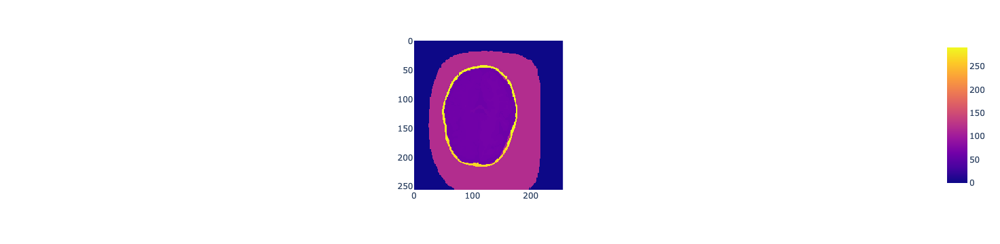

In [3]:
# fn = "/mnt/raid/C1_ML_Analysis/source/blender/simulated_data_export/FAM-202-1960-2_mesh_sampling/AC/98.nrrd"
fn = "/mnt/raid/C1_ML_Analysis/source/blender/simulated_data_export/FAM-202-1960-2_mesh_sampling/BPD/119.nrrd"
img = sitk.ReadImage(fn)
img1_np = sitk.GetArrayFromImage(img).astype(np.int32)
px.imshow(img1_np[0])

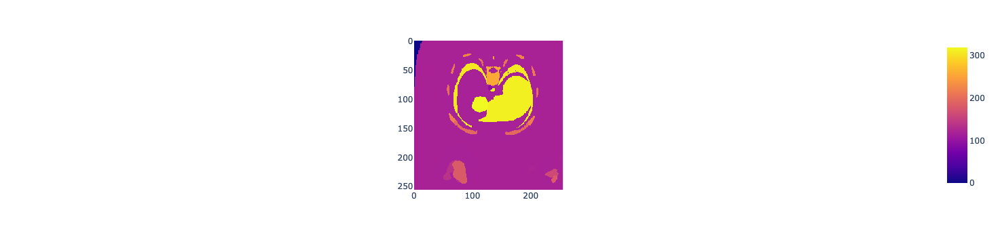

In [4]:
fn2 = "/mnt/raid/C1_ML_Analysis/source/blender/simulated_data_export/FAM-202-1960-2_mesh_sampling/AC/40.nrrd"
img2 = sitk.ReadImage(fn2)
img2_np = sitk.GetArrayFromImage(img2).astype(np.int32)
px.imshow(img2_np[0])

/mnt/raid/home/jprieto/anaconda3/envs/lotus/lib/python3.10/site-packages/torch/nn/functional.py:4236: UserWarning:

Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.



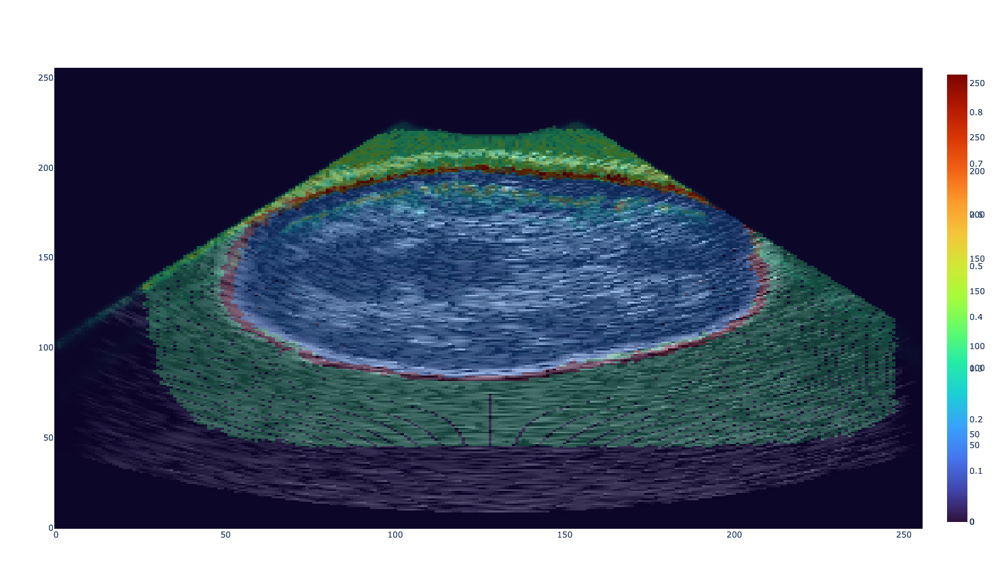

In [5]:
fn_must = "/mnt/raid/C1_ML_Analysis/source/blender/simulated_data_export/FAM-202-1960-2_mesh_diffusor_sampling_must/BPD/119.nrrd"
img_must_np = sitk.GetArrayFromImage(sitk.ReadImage(fn_must)).astype(np.int32)


acoustic_params_fn = '/mnt/raid/C1_ML_Analysis/source/blender/simulated_data_export/FAM-202-1960-2_mesh_acoustic_params.csv'
# acoustic_params_df = pd.read_csv('/mnt/raid/C1_ML_Analysis/source/blender/simulated_data_export/FAM-202-1960-2_mesh_acoustic_params.csv')
us_render = UltrasoundRendering(num_labels=330, w=256, h=256, center_x=128.0, center_y=-2.5, r1=40.0, r2=250.0, theta=np.pi/4.5
                               )
us_render.init_params(acoustic_params_fn)
fake_us = us_render(torch.randint(low=0, high=10, size=(2, 1, 256, 256)))

img_np = np.stack([img1_np, img2_np])
t = torch.tensor(img_np).to(torch.long)

# t = transforms.functional.affine(t, angle=0, scale=1, shear=0, translate=[-5, 0])

fake_us = us_render(t.permute(0, 1, 3, 2))

fig = go.Figure()
fig.add_trace(go.Heatmap(z=np.flip(img_must_np, axis=0), colorscale='gray'))
fig.add_trace(go.Heatmap(z=np.flip(fake_us[0][0].detach().numpy().squeeze(), axis=0), colorscale='jet', opacity=0.25))
fig.add_trace(go.Heatmap(z=np.flip(fake_us[1][0].detach().numpy().squeeze(), axis=0), colorscale='turbo', opacity=0.25))

fig.update_layout(
            autosize=False,
            width=860,
            height=860
        )

fig

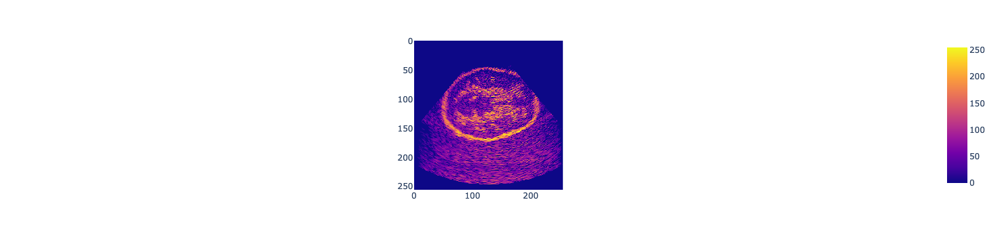

In [6]:
px.imshow(img_must_np)

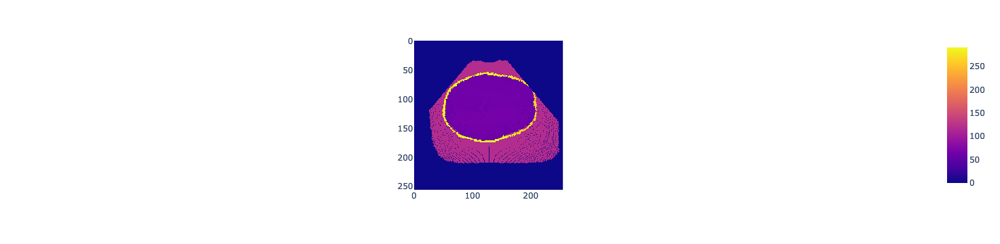

In [7]:
px.imshow(fake_us[1][0].detach().numpy().squeeze())

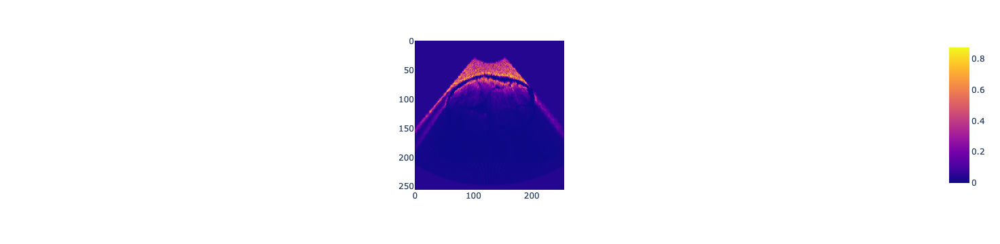

In [8]:
px.imshow(fake_us[0][0].detach().numpy().squeeze())

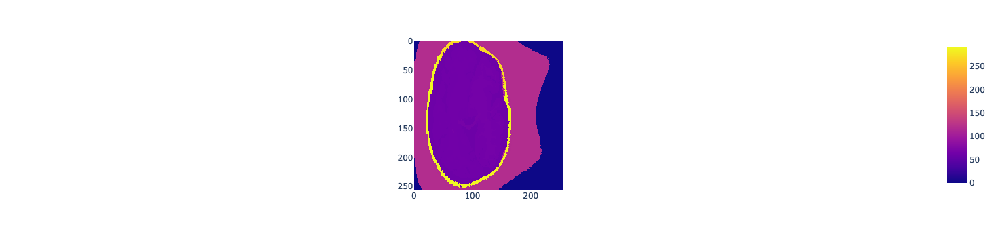

In [9]:
px.imshow(fake_us[9][0].detach().numpy().squeeze())

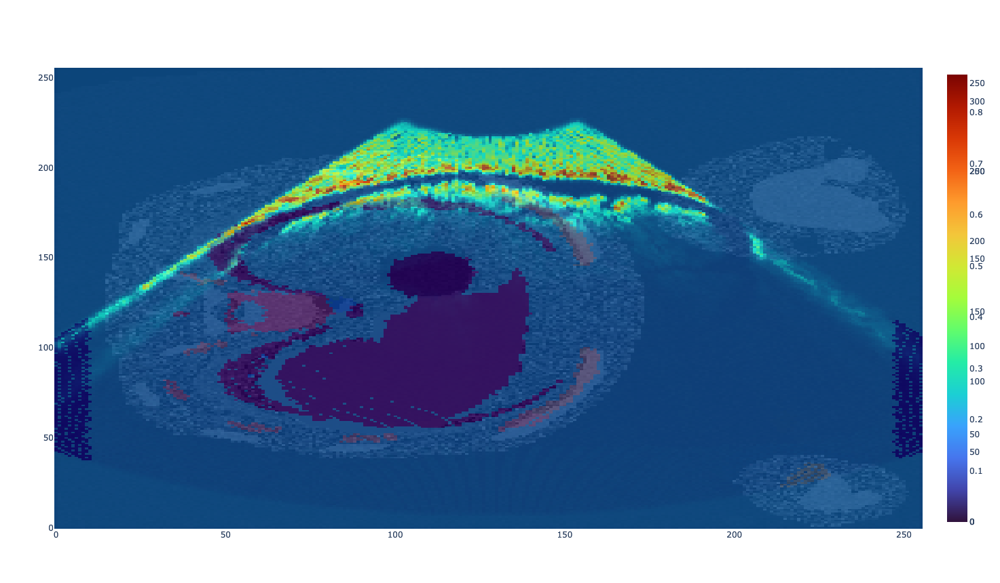

In [10]:
fn_must_2 = "/mnt/raid/C1_ML_Analysis/source/blender/simulated_data_export/FAM-202-1960-2_mesh_diffusor_sampling/AC/40.nrrd"
img_must_2_np = sitk.GetArrayFromImage(sitk.ReadImage(fn_must_2)).squeeze().transpose()

fig = go.Figure()
fig.add_trace(go.Heatmap(z=np.flip(img_must_2_np, axis=0), colorscale='gray'))
fig.add_trace(go.Heatmap(z=np.flip(fake_us[0][0].detach().numpy().squeeze(), axis=0), colorscale='jet', opacity=0.8))
fig.add_trace(go.Heatmap(z=np.flip(fake_us[1][1].detach().numpy().squeeze(), axis=0), colorscale='turbo', opacity=0.25))

fig.update_layout(
            autosize=False,
            width=860,
            height=860
        )

fig

In [11]:
img_must_2_np

array([[ 3.01515425,  2.82514121,  4.29475386, ..., 35.        ,
        29.        , 35.        ],
       [ 0.        ,  1.58125692,  1.25205956, ..., 20.        ,
        27.        , 35.        ],
       [ 2.35144955,  5.10511389,  7.22145619, ..., 25.        ,
        27.        , 32.        ],
       ...,
       [28.        , 27.        , 37.        , ..., 32.        ,
        38.        , 32.        ],
       [28.        , 32.        , 31.        , ..., 27.        ,
        38.        , 32.        ],
       [32.        , 34.        , 31.        , ..., 34.        ,
        32.        , 25.        ]])